# Figure 3: Cerebellum-specfic ALE (C-SALE) maps for Behavioural Subdomains, 
## Full unthresholded maps with thresholded (p < 0.001 and k = 50) overlays. 

#### Author: Neville Magielse
#### Date: 05.08.2024

In [3]:
import os
import sys

# User-specified base working directory
BASE_DIR = '/data/project/cerebellum_ale/'  # Change this to your project folder. Make sure they have input and output folders.

# Defines input and output paths.
INPUT_DIR = os.path.join(BASE_DIR, 'input')
OUTPUT_DIR = os.path.join(BASE_DIR, 'output')

sys.path.append(os.path.join(BASE_DIR, 'scripts'))

In [4]:
# Imports
import numpy as np
import pandas as pd

import scipy
import scipy.spatial

import matplotlib.pyplot as plt
import matplotlib.colors
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import Patch
import matplotlib.cm

import seaborn as sns
import nilearn.plotting, nilearn.maskers, nilearn.surface
import nibabel as nib

import nimare
from nimare.meta.cbma.ale import ALE
from nimare.correct import FWECorrector

# sys.path.append(os.path.join(BASE_DIR, 'scripts')). Utils is a custom python file with somme functions defined for this project.
from utils import cluster_extent_correction

import SUITPy.flatmap

from itertools import islice

In [5]:
# Create a font language
plt.rcParams["font.family"] = "Asana Math"
plt.rcParams["font.size"] = 14
plt.rcParams["figure.dpi"] = 192

# Import C-SALE data

In [6]:
# Create dictionaires
zmaps = {}
surf_zmaps = {}
#zmaps_thr = {}
#surf_zmaps_thr = {}
zmaps_thr_strict = {}
surf_zmaps_thr_strict = {}

domains = ['Action', 'Cognition', 'Emotion', 'Perception', 'Interoception'] # Only domains are necessary, since we automatically include all directories (assuming these are all subdomain folders).
# subdomains = ['Execution', 'Execution.Speech', 'Imagination', 'Inhibition', 'MotorLearning', 'Observation', 'Preparation', 'Attention', 'Language', 'Language.Orthography', 'Language.Phonology', 'Language.Semantics', 'Language.Speech', 'Language.Syntax','Memory', 'Memory.Explicit', 'Memory.Working','Music', 'Reasoning', 'SocialCognition', 'Spatial', 'Temporal', 'Negative', 'Negative.Anger', 'Negative.Anxiety', 'Negative.Disgust', 'Negative.Fear', 'Negative.Sadness', 'Positive', 'Positive.Happiness', 'Positive.RewardGain', 'Valence', 'Hunger', 'RespirationRegulation', 'Sexuality', 'Audition', 'Gustation', 'Olfaction', 'Somesthesis', 'Somesthesis.Pain','Vision', 'Vision.Color','Vision.Motion', 'Vision.Shape']
MASK_NAME = 'D2009_MNI'
mask_img = os.path.join(INPUT_DIR, f'maps/{MASK_NAME}.nii.gz')
k = 50

all_subdomains = []  # Initialize an empty list to store all subdomains

for domain in domains:
    domain_path = os.path.join(OUTPUT_DIR, 'SALE', f'{domain}')
    all_domains = os.listdir(domain_path)
    
    # Exclude subdomains with the same name as the domains
    subdomains = [subdomain for subdomain in all_domains if subdomain not in domains]
    all_subdomains.extend(subdomains)  # Add the subdomains to the list
    
    for subdomain in subdomains:
        subdomain_path = os.path.join(domain_path, subdomain)
        if (not os.path.isdir(subdomain_path)):
            continue
        print(subdomain)
        # load uncorrected results
        z_orig = nib.load(os.path.join(subdomain_path, 'uncorr_z.nii.gz'))
        # mask to the proper mask
        z_masked = nilearn.image.math_img("m * img", img=z_orig, m=mask_img)
        # record 3d and flattened unthresholded images
        zmaps[subdomain] = z_masked
        surf_zmaps[subdomain] = SUITPy.flatmap.vol_to_surf(zmaps[subdomain], space = 'SPM').squeeze()
        # do cluster extent thresholding if needed
        # corr_cluster_z_path = os.path.join(subdomain_path, f'corr_cluster_h-01_k-{k}_mask-{MASK_NAME}_z.nii.gz')
        corr_cluster_z_path_strict = os.path.join(subdomain_path, f'corr_cluster_h-001_k-{k}_mask-{MASK_NAME}_z.nii.gz')
        #if not os.path.exists(corr_cluster_z_path):
         #   logp_orig = nib.load(os.path.join(subdomain_path, 'uncorr_logp.nii.gz'))
          #  logp_masked = nilearn.image.math_img("m * img", img=logp_orig, m=mask_img)
            # cluster extent correction
           # cres = cluster_extent_correction({'z': z_masked, 'logp': logp_masked}, k=50, height_thr=0.01)
            # save corrected results
            #for map_name, img in cres.items():
             #   img.to_filename(os.path.join(subdomain_path, f'corr_cluster_h-01_k-{k}_mask-{MASK_NAME}_{map_name}.nii.gz'))
        # record 3d and flattened leniently thresholded (p < 0.01  and K = 50) images
        #zmaps_thr[subdomain] = nib.load(corr_cluster_z_path)
        #surf_zmaps_thr[subdomain] = SUITPy.flatmap.vol_to_surf(zmaps_thr[subdomain], space ='SPM').squeeze()
        # record 3d and flattened thresholded (Strict, p < 0.001 and K = 50) images
        zmaps_thr_strict[subdomain] = nib.load(corr_cluster_z_path_strict)
        surf_zmaps_thr_strict[subdomain] = SUITPy.flatmap.vol_to_surf(zmaps_thr_strict[subdomain], space = 'SPM').squeeze()

Action.Imagination
Action.Execution
Action.Observation
Action.Inhibition
Action.Execution.Speech
Cognition.Language
Cognition.Memory
Cognition.Attention
Cognition.Language.Speech
Cognition.Language.Semantics
Cognition.Language.Phonology
Cognition.SocialCognition
Cognition.Reasoning
Cognition.Spatial
Cognition.Language.Orthography
Cognition.Memory.Explicit
Cognition.Music
Cognition.Memory.Working
Emotion.Positive.Happiness
Emotion.Negative.Sadness
Emotion.Negative.Fear
Emotion.Positive
Emotion.Negative.Disgust
Emotion.Positive.RewardGain
Emotion.Negative.Anger
Emotion.Negative
Perception.Somesthesis.Pain
Perception.Olfaction
Perception.Vision
Perception.Audition
Perception.Vision.Motion
Perception.Somesthesis
Perception.Vision.Color
Perception.Vision.Shape
Interoception.Sexuality


# Create Figure 3

# Unthresholded z-maps with thresholded overlays.

In [7]:
flat_mesh = nilearn.surface.load_surf_mesh(os.path.join(INPUT_DIR, 'maps/FLAT.surf.gii'))
flat_mesh

mesh(coordinates=array([[ 21.189785 ,   2.5686152,   0.       ],
       [ 20.541264 ,   2.4435081,   0.       ],
       [ 19.67503  ,   1.8180358,   0.       ],
       ...,
       [-29.824383 ,  74.66718  ,   0.       ],
       [-29.369013 ,  75.676094 ,   0.       ],
       [-29.696808 ,  75.297424 ,   0.       ]], dtype=float32), faces=array([[    0,     1,     7],
       [    8,     7,     1],
       [    0,   138,     1],
       ...,
       [27862, 27938, 27871],
       [27862, 27943, 27938],
       [27871, 27938, 27879]], dtype=int32))

## Test for one Subdomain

In [8]:
# def get_flatmap_mask_boundaries(mask)
mask = (surf_zmaps_thr_strict['Action.Execution']>0).astype(int)
outline = np.zeros_like(mask, dtype=int)
mesh = flat_mesh
boundary_faces = (mask[mesh.faces].sum(axis=1) == 1)
mask_boundary_verts = list(
    set(mesh.faces[boundary_faces].flatten()) & \
    set(np.where(mask)[0])
)
outline[mask_boundary_verts] = 1

In [9]:
iterations = 2
cluster_borders = mesh.coordinates[mask_boundary_verts]
for i in range(iterations):
    distmat = scipy.spatial.distance_matrix(cluster_borders, cluster_borders)
    distmat[distmat==0] = np.NaN
    neighbors = np.where(distmat < 5)
    new_points = (cluster_borders[neighbors[0]] + cluster_borders[neighbors[1]]) / 2
    cluster_borders = np.concatenate([cluster_borders, new_points], axis=0)

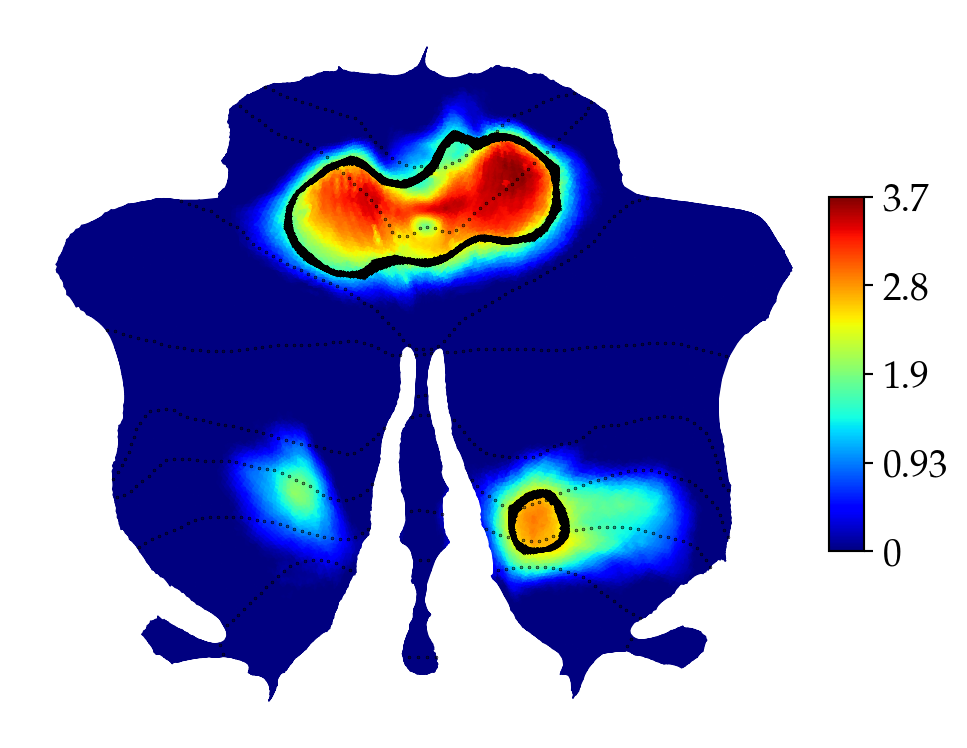

In [10]:
fig, ax = plt.subplots()
bordersize = 0.5
SUITPy.flatmap.plot(
    surf_zmaps['Action.Execution'],
    colorbar=True, new_figure=False, bordersize=bordersize)

ax.plot(cluster_borders[:,0],cluster_borders[:,1],color='black',
                marker='.', linestyle=None,
                markersize=0.5,linewidth=0)

# Now as loop over subdomains

In [11]:
def get_flatmap_mask_boundaries(subdomain, surf_zmaps_thr):
    mask = (surf_zmaps_thr_strict[subdomain] > 0).astype(int)
    outline = np.zeros_like(mask, dtype=int)
    mesh = nilearn.surface.load_surf_mesh(os.path.join(INPUT_DIR, 'maps/FLAT.surf.gii'))
    boundary_faces = (mask[mesh.faces].sum(axis=1) == 1)
    mask_boundary_verts = list(
        set(mesh.faces[boundary_faces].flatten()) & \
        set(np.where(mask)[0])
    )
    outline[mask_boundary_verts] = 1
    return outline

In [12]:
# Specifiy the domains
domains = ['Action', 'Cognition', 'Emotion', 'Interoception', 'Perception']

# Dictionary to store boundaries for each domain
boundaries_dict_strict = {}

# Iterate over domains and compute boundaries
for subdomain in all_subdomains:
    boundaries_dict_strict[subdomain] = get_flatmap_mask_boundaries(subdomain, surf_zmaps_thr_strict)

# This should now have put boundaries for every subdomain in boundaries_dict
# Check that keys exist for all subdomains.

In [13]:
# Load the surface mesh
mesh = flat_mesh

# Initialize dictionaries to store cluster borders, outline, and boundary faces for each domain
cluster_borders_dict_strict = {}
outline_dict_strict = {}
boundary_faces_dict_strict = {}

# Loop over domains
for subdomain in all_subdomains:
    # Get the binary mask for the current domain
    mask = (surf_zmaps_thr_strict[subdomain] > 0).astype(int)

    # Get the coordinates of the boundary vertices for the current domain
    outline_dict_strict[subdomain] = np.zeros_like(mask, dtype=int)
    boundary_faces_strict = (mask[mesh.faces].sum(axis=1) == 1)
    mask_boundary_verts_strict = list(
        set(mesh.faces[boundary_faces_strict].flatten()) & set(np.where(mask)[0])
    )
    cluster_borders_dict_strict[subdomain] = mesh.coordinates[mask_boundary_verts_strict]

    # Smoothing iterations
    iterations = 2
    for i in range(iterations):
        distmat = scipy.spatial.distance_matrix(cluster_borders_dict_strict[subdomain], cluster_borders_dict_strict[subdomain])
        distmat[distmat == 0] = np.NaN
        neighbors = np.where(distmat < 5)
        new_points = (cluster_borders_dict_strict[subdomain][neighbors[0]] + cluster_borders_dict_strict[subdomain][neighbors[1]]) / 2
        cluster_borders_dict_strict[subdomain] = np.concatenate([cluster_borders_dict_strict[subdomain], new_points], axis=0)

# This should have created a dicitionary of border outlines on the SUIT surface for every one of your (sub)BDs. Verify this. 
## Note that some parts of the outline may be somewhat wonky due to difficulties in mapping vertices to a 2D-surface.

In [14]:
# Add nicer labels to the sets of experiments/subdomains.
subdomain_labels = {'Action.MotorLearning': 'Motor Learning',
                  'Action.Observation': 'Observation',
                  'Action.Execution.Speech': 'Speech Execution',
                  'Action.Inhibition': 'Inhibition',
                  'Action.Execution': 'Execution',
                  'Action.Preparation': 'Preparation',
                  'Action.Imagination': 'Imagination',
                  'Cognition.Spatial': 'Spatial',
                  'Cognition.SocialCognition': 'Social Cognition',
                  'Cognition.Attention': 'Attention',
                  'Cognition.Language.Syntax': 'Syntax',
                  'Cognition.Memory': 'Memory',
                  'Cognition.Memory.Explicit': 'Explicit Memory',
                  'Cognition.Language': 'Language',
                  'Cognition.Language.Semantics': 'Semantics',
                  'Cognition.Memory.Working': 'Working Memory',
                  'Cognition.Language.Phonology': 'Phonology',
                  'Cognition.Reasoning': 'Reasoning',
                  'Cognition.Temporal': 'Temporal',
                  'Cognition.Language.Speech': 'Speech',
                  'Cognition.Language.Orthography': 'Orthography',
                  'Cognition.Music': 'Music',
                  'Emotion.Positive.RewardGain': 'Reward/ Gain',
                  'Emotion.Negative.Disgust': 'Disgust',
                  'Emotion.Positive': 'Positive Emotion',
                  'Emotion.Negative.Fear': 'Fear',
                  'Emotion.Positive.Happiness': 'Happiness',
                  'Emotion.Negative.Sadness': 'Sadness',
                  'Emotion.Negative': 'Negative Emotion',
                  'Emotion.Valence': 'Valence',
                  'Emotion.Negative.Anger': 'Anger',
                  'Emotion.Negative.Anxiety': 'Anxiety',
                  'Perception.Vision': 'Vision',
                  'Perception.Olfaction': 'Olfaction',
                  'Perception.Vision.Motion': 'Vision - Motion',
                  'Perception.Gustation': 'Gustation',
                  'Perception.Somesthesis.Pain': 'Pain',
                  'Perception.Audition': 'Audition',
                  'Perception.Somesthesis': 'Somesthesis',
                  'Perception.Vision.Color': 'Vision - Color',
                  'Perception.Vision.Shape': 'Vision - Shape',
                  'Interoception.Sexuality': 'Sexuality',
                  'Interoception.RespirationRegulation': 'Respiration Regulation',
                  'Interoception.Hunger': 'Hunger'
  
}

In [15]:
# Add the number of experiments per subdomain.
subdomain_exps = {'Action.Observation': 17,
                  'Action.Execution.Speech': 47,
                  'Action.Inhibition': 36,
                  'Action.Execution': 198,
                  'Action.Imagination': 18,
                  'Cognition.Spatial': 22,
                  'Cognition.SocialCognition': 46,
                  'Cognition.Attention': 224,
                  'Cognition.Memory': 219,
                  'Cognition.Memory.Explicit': 102,
                  'Cognition.Language': 201,
                  'Cognition.Language.Semantics': 121,
                  'Cognition.Memory.Working': 113,
                  'Cognition.Language.Phonology': 35,
                  'Cognition.Reasoning': 111,
                  'Cognition.Language.Speech': 83,
                  'Cognition.Language.Orthography': 24,
                  'Cognition.Music': 37,
                  'Emotion.Positive.RewardGain': 82,
                  'Emotion.Negative.Disgust': 16, # Take into consideration N < 17 may be less than ideal.
                  'Emotion.Positive': 135,
                  'Emotion.Negative.Fear': 37,
                  'Emotion.Positive.Happiness': 25,
                  'Emotion.Negative.Sadness': 24,
                  'Emotion.Negative': 115,
                  'Emotion.Negative.Anger': 16, # Take into consideration N < 17 may be less than ideal.
                  'Perception.Vision': 186,
                  'Perception.Olfaction': 17,
                  'Perception.Vision.Motion': 30,
                  'Perception.Somesthesis.Pain': 65,
                  'Perception.Audition': 61,
                  'Perception.Somesthesis': 90,
                  'Perception.Vision.Color': 23,
                  'Perception.Vision.Shape': 65,
                  'Interoception.Sexuality': 30
}

In [16]:
# Order the domains based on the number of experiments
subdomain_order = pd.Series(subdomain_exps).sort_values().index # This also makes sure we just plot the subdomains for which C-SALE was actually run.

Subdomain 'Emotion.Negative.Anger' map is empty. Skipping.
Subdomain 'Emotion.Negative.Disgust' map is empty. Skipping.
Subdomain 'Perception.Olfaction' map is empty. Skipping.
Subdomain 'Action.Imagination' map is empty. Skipping.
Subdomain 'Cognition.Spatial' map is empty. Skipping.
Subdomain 'Perception.Vision.Color' map is empty. Skipping.
Subdomain 'Cognition.Language.Orthography' map is empty. Skipping.
Subdomain 'Emotion.Positive.Happiness' map is empty. Skipping.
Subdomain 'Interoception.Sexuality' map is empty. Skipping.
Subdomain 'Cognition.Language.Phonology' map is empty. Skipping.
Subdomain 'Action.Inhibition' map is empty. Skipping.
Subdomain 'Cognition.Music' map is empty. Skipping.
Subdomain 'Emotion.Negative.Fear' map is empty. Skipping.
Subdomain 'Perception.Audition' map is empty. Skipping.
Subdomain 'Perception.Somesthesis.Pain' map is empty. Skipping.
Subdomain 'Emotion.Positive.RewardGain' map is empty. Skipping.
Subdomain 'Cognition.Language.Speech' map is empty.

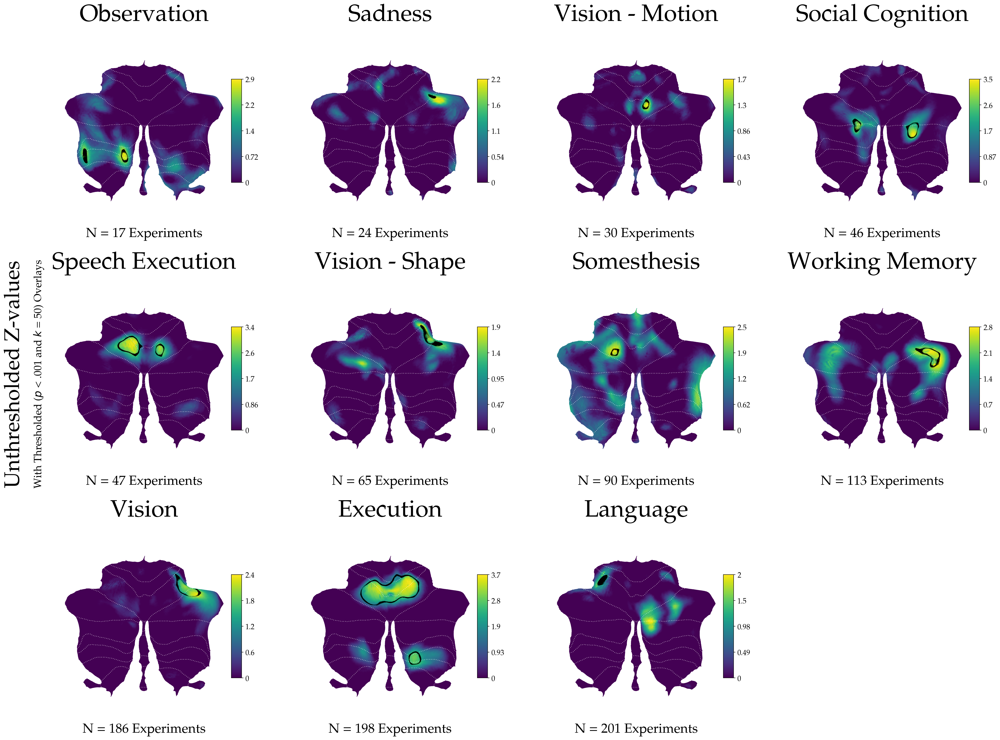

In [23]:
# Create a new figure
fig = plt.figure(figsize=(32, 24))  # Adjust to your publication preferences.

# Filter out subdomains that don't exist or have empty maps
valid_subdomains = []
for subdomain in subdomain_order:
    # Check if the subdomain exists in the dictionary
    if subdomain not in surf_zmaps:
        print(f"Subdomain '{subdomain}' does not exist. Skipping.")
        continue
    
    # Check if the map is completely empty (all values are zero)
    if np.all(surf_zmaps_thr_strict[subdomain] == 0):
        print(f"Subdomain '{subdomain}' map is empty. Skipping.")
        continue
    
    # If both checks pass, add the subdomain to valid_subdomains
    valid_subdomains.append(subdomain)

# Determine the number of valid subdomains
num_subdomains = len(valid_subdomains)

# Set the grid size (adjust these numbers based on your preference)
n_rows = 3
n_cols = 4

# Adjust the grid size dynamically if necessary
if num_subdomains > n_rows * n_cols:
    raise ValueError(f"Grid size {n_rows}x{n_cols} is too small for {num_subdomains} subdomains.")

# Loop over valid subdomains and create subplots
for i, subdomain in enumerate(valid_subdomains):
    ax = fig.add_subplot(n_rows, n_cols, i + 1)
    
    # Plot the unthresholded background map for each domain using a color blind-friendly colormap
    SUITPy.flatmap.plot(surf_zmaps[subdomain], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')

    # Overlay the cluster borders
    ax.plot(cluster_borders_dict_strict[subdomain][:, 0], cluster_borders_dict_strict[subdomain][:, 1], 
            color='black', marker='.', linestyle=None, markersize=0.01, linewidth=0)

    # Set titles and labels as desired
    ax.set_title(f"{subdomain_labels[subdomain]}", fontsize=45)
    ax.text(0.5, 0.0, f'N = {subdomain_exps[subdomain]} Experiments', fontsize=25, 
            ha='center', va='center', transform=ax.transAxes)

# Add a rotated y-label for the entire plot
fig.text(0.09, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Add a subtitle for the y-label
fig.text(0.11, 0.5, 'With Thresholded ($\mathit{p}$ < .001 and $\mathit{k}$ = 50) Overlays', 
         va='center', ha='center', rotation='vertical', fontsize=20)

# Show the plot
plt.show()


In [24]:
# Decide if you want to save the figure
fig.savefig(os.path.join(BASE_DIR, 'Figures/Publication/Figure3/3a_SALE-Subd_unthres_wThres.png'), bbox_inches='tight')

# Figure 3, but ordered by Domain first, then by sample size.

Subdomain 'Action.Imagination' map is empty. Skipping.
Subdomain 'Action.Inhibition' map is empty. Skipping.
Subdomain 'Cognition.Spatial' map is empty. Skipping.
Subdomain 'Cognition.Language.Orthography' map is empty. Skipping.
Subdomain 'Cognition.Language.Phonology' map is empty. Skipping.
Subdomain 'Cognition.Music' map is empty. Skipping.
Subdomain 'Cognition.Language.Speech' map is empty. Skipping.
Subdomain 'Cognition.Memory.Explicit' map is empty. Skipping.
Subdomain 'Cognition.Reasoning' map is empty. Skipping.
Subdomain 'Cognition.Language.Semantics' map is empty. Skipping.
Subdomain 'Cognition.Memory' map is empty. Skipping.
Subdomain 'Cognition.Attention' map is empty. Skipping.
Subdomain 'Emotion.Negative.Anger' map is empty. Skipping.
Subdomain 'Emotion.Negative.Disgust' map is empty. Skipping.
Subdomain 'Emotion.Positive.Happiness' map is empty. Skipping.
Subdomain 'Emotion.Negative.Fear' map is empty. Skipping.
Subdomain 'Emotion.Positive.RewardGain' map is empty. Skip

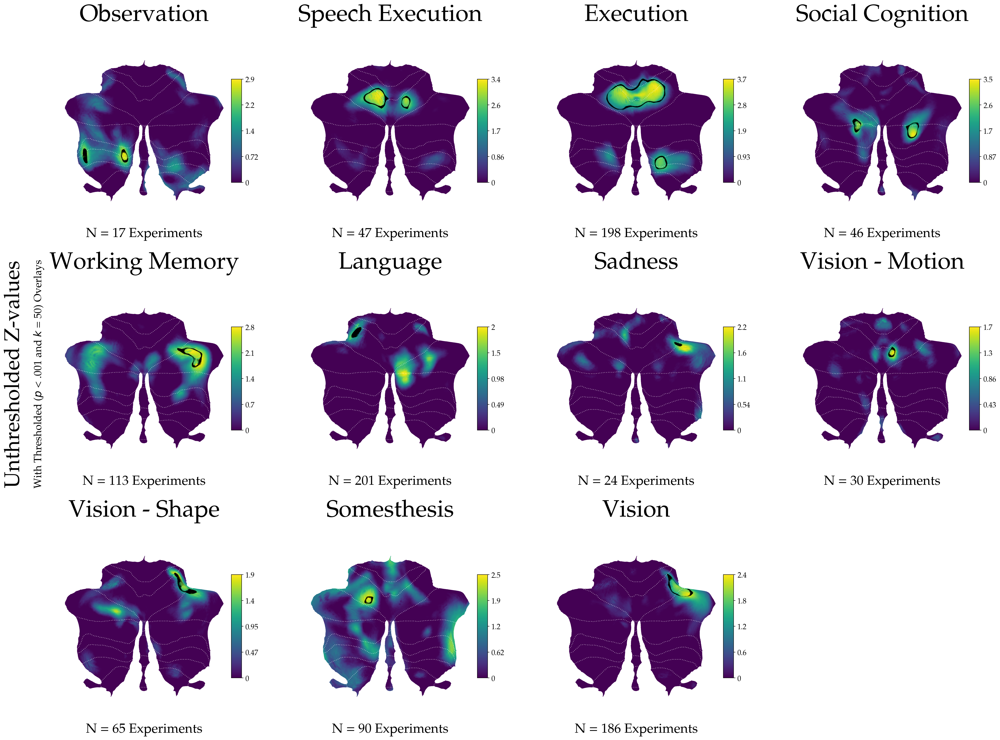

In [18]:
# Create a new figure
fig = plt.figure(figsize=(32, 24))  # Adjust to your publication preferences.

# Extract the domain from each subdomain and pair it with the subdomain and number of experiments
subdomain_info = []
for subdomain in subdomain_order:
    # Extract domain name (everything before the first period)
    domain = subdomain.split('.')[0]
    # Get the number of experiments for sorting
    num_exps = subdomain_exps[subdomain]
    # Add to the list for sorting
    subdomain_info.append((domain, num_exps, subdomain))

# Sort first by domain, then by the number of experiments
subdomain_info_sorted = sorted(subdomain_info, key=lambda x: (x[0], x[1]))

# Filter out subdomains that don't exist or have empty maps, after sorting
valid_subdomains = []
for domain, num_exps, subdomain in subdomain_info_sorted:
    # Check if the subdomain exists in the dictionary
    if subdomain not in surf_zmaps:
        print(f"Subdomain '{subdomain}' does not exist. Skipping.")
        continue
    
    # Check if the map is completely empty (all values are zero)
    if np.all(surf_zmaps_thr_strict[subdomain] == 0):
        print(f"Subdomain '{subdomain}' map is empty. Skipping.")
        continue
    
    # If both checks pass, add the subdomain to valid_subdomains
    valid_subdomains.append(subdomain)

# Determine the number of valid subdomains
num_subdomains = len(valid_subdomains)

# Set the grid size (adjust these numbers based on your preference)
n_rows = 3
n_cols = 4

# Adjust the grid size dynamically if necessary
if num_subdomains > n_rows * n_cols:
    raise ValueError(f"Grid size {n_rows}x{n_cols} is too small for {num_subdomains} subdomains.")

# Loop over valid subdomains and create subplots
for i, subdomain in enumerate(valid_subdomains):
    ax = fig.add_subplot(n_rows, n_cols, i + 1)
    
    # Plot the unthresholded background map for each domain using a color blind-friendly colormap
    SUITPy.flatmap.plot(surf_zmaps[subdomain], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')

    # Overlay the cluster borders
    ax.plot(cluster_borders_dict_strict[subdomain][:, 0], cluster_borders_dict_strict[subdomain][:, 1], 
            color='black', marker='.', linestyle=None, markersize=0.01, linewidth=0)

    # Set titles and labels as desired
    ax.set_title(f"{subdomain_labels[subdomain]}", fontsize=45)
    ax.text(0.5, 0.0, f'N = {subdomain_exps[subdomain]} Experiments', fontsize=25, 
            ha='center', va='center', transform=ax.transAxes)

# Add a rotated y-label for the entire plot
fig.text(0.09, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Add a subtitle for the y-label
fig.text(0.11, 0.5, 'With Thresholded ($\mathit{p}$ < .001 and $\mathit{k}$ = 50) Overlays', 
         va='center', ha='center', rotation='vertical', fontsize=20)

# Show the plot
plt.show()


In [20]:
# Decide if you want to save the figure
fig.savefig(os.path.join(BASE_DIR, 'Figures/Publication/Figure3/3a_SALE-Subd_unthres_wThres_BD-ordered.png'), bbox_inches='tight')

# Make the Supplementary Figure that has all the unthresholded maps, so regardless of whether they passed the threshold.

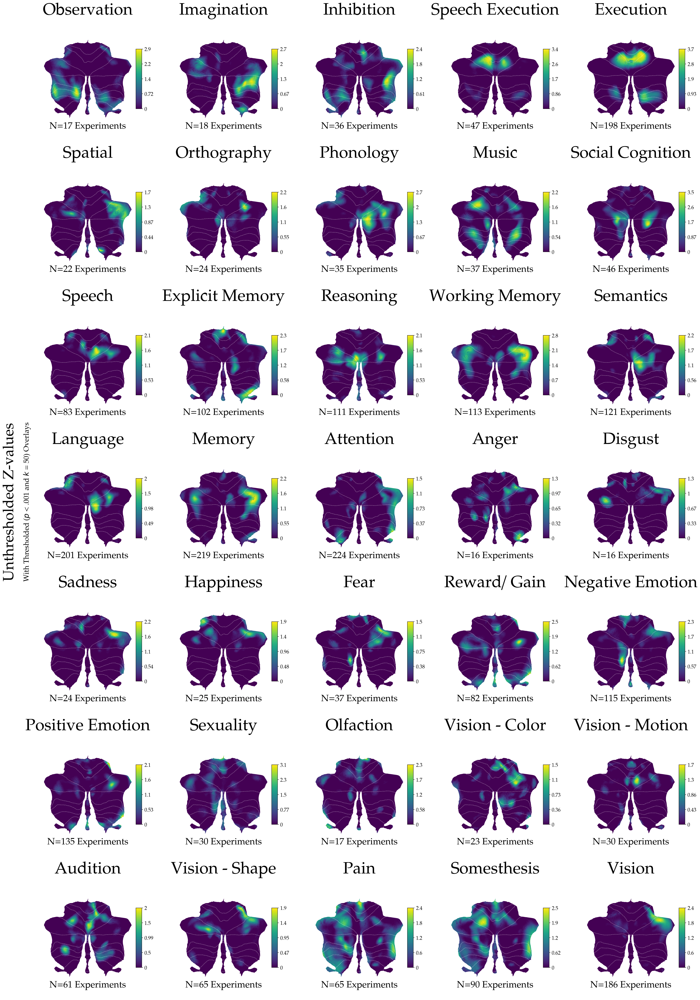

In [21]:
# Create a new figure
fig = plt.figure(figsize=(32, 48))  # Adjust to your publication preferences.

# Extract the domain from each subdomain and pair it with the subdomain and number of experiments
subdomain_info = []
for subdomain in subdomain_order:
    # Extract domain name (everything before the first period)
    domain = subdomain.split('.')[0]
    # Get the number of experiments for sorting
    num_exps = subdomain_exps[subdomain]
    # Add to the list for sorting
    subdomain_info.append((domain, num_exps, subdomain))

# Sort first by domain, then by the number of experiments
subdomain_info_sorted = sorted(subdomain_info, key=lambda x: (x[0], x[1]))

# Filter out subdomains that don't exist or have empty maps, after sorting
valid_subdomains = []
for domain, num_exps, subdomain in subdomain_info_sorted:
    # Check if the subdomain exists in the dictionary
    if subdomain not in surf_zmaps:
        print(f"Subdomain '{subdomain}' does not exist. Skipping.")
        continue
    
    # If the map exists, add it to the list of valid subdomain names.
    valid_subdomains.append(subdomain)

# Determine the number of valid subdomains
num_subdomains = len(valid_subdomains)

# Set the grid size (adjust these numbers based on your preference/ numbers of valid analyses)
n_rows = 7
n_cols = 5

# Adjust the grid size dynamically if necessary
if num_subdomains > n_rows * n_cols:
    raise ValueError(f"Grid size {n_rows}x{n_cols} is too small for {num_subdomains} subdomains.")

# Loop over valid subdomains and create subplots
for i, subdomain in enumerate(valid_subdomains):
    ax = fig.add_subplot(n_rows, n_cols, i + 1)
    
    # Plot the unthresholded background map for each domain using a color blind-friendly colormap
    SUITPy.flatmap.plot(surf_zmaps[subdomain], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')

    # Set titles and labels as desired
    ax.set_title(f"{subdomain_labels[subdomain]}", fontsize=45)
    ax.text(0.5, 0.1, f'N={subdomain_exps[subdomain]} Experiments', fontsize=25, 
            ha='center', va='center', transform=ax.transAxes)

# Add a rotated y-label for the entire plot
fig.text(0.09, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Add a subtitle for the y-label
fig.text(0.11, 0.5, 'With Thresholded ($\mathit{p}$ < .001 and $\mathit{k}$ = 50) Overlays', 
         va='center', ha='center', rotation='vertical', fontsize=20)

# Show the plot
plt.show()


In [22]:
# Decide if you want to save the figure
fig.savefig(os.path.join(BASE_DIR, 'Figures/Publication/Figure3/Supplementary/SALE-Subd_unthres-full.png'), bbox_inches='tight')

# Just the thresholded maps.

Subdomain 'Action.Imagination' map is empty. Skipping.
Subdomain 'Action.Inhibition' map is empty. Skipping.
Subdomain 'Cognition.Spatial' map is empty. Skipping.
Subdomain 'Cognition.Language.Orthography' map is empty. Skipping.
Subdomain 'Cognition.Language.Phonology' map is empty. Skipping.
Subdomain 'Cognition.Music' map is empty. Skipping.
Subdomain 'Cognition.Language.Speech' map is empty. Skipping.
Subdomain 'Cognition.Memory.Explicit' map is empty. Skipping.
Subdomain 'Cognition.Reasoning' map is empty. Skipping.
Subdomain 'Cognition.Language.Semantics' map is empty. Skipping.
Subdomain 'Cognition.Memory' map is empty. Skipping.
Subdomain 'Cognition.Attention' map is empty. Skipping.
Subdomain 'Emotion.Negative.Anger' map is empty. Skipping.
Subdomain 'Emotion.Negative.Disgust' map is empty. Skipping.
Subdomain 'Emotion.Positive.Happiness' map is empty. Skipping.
Subdomain 'Emotion.Negative.Fear' map is empty. Skipping.
Subdomain 'Emotion.Positive.RewardGain' map is empty. Skip

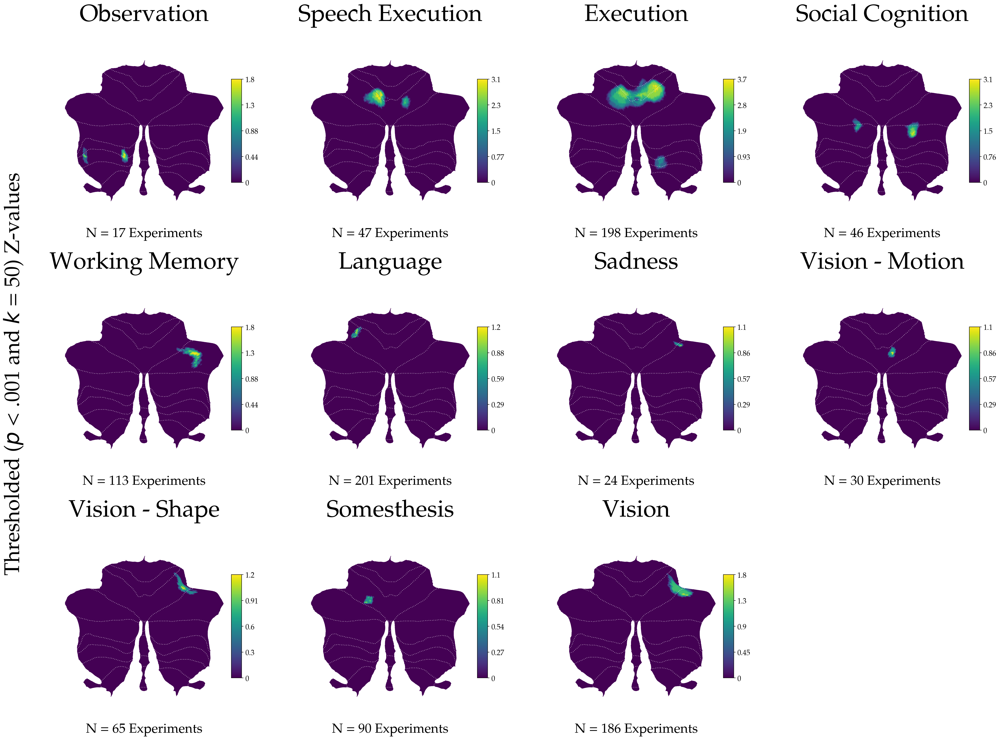

In [25]:
# Create a new figure
fig = plt.figure(figsize=(32, 24))  # Adjust to your publication preferences.

# Extract the domain from each subdomain and pair it with the subdomain and number of experiments
subdomain_info = []
for subdomain in subdomain_order:
    # Extract domain name (everything before the first period)
    domain = subdomain.split('.')[0]
    # Get the number of experiments for sorting
    num_exps = subdomain_exps[subdomain]
    # Add to the list for sorting
    subdomain_info.append((domain, num_exps, subdomain))

# Sort first by domain, then by the number of experiments
subdomain_info_sorted = sorted(subdomain_info, key=lambda x: (x[0], x[1]))

# Filter out subdomains that don't exist or have empty maps, after sorting
valid_subdomains = []
for domain, num_exps, subdomain in subdomain_info_sorted:
    # Check if the subdomain exists in the dictionary
    if subdomain not in surf_zmaps:
        print(f"Subdomain '{subdomain}' does not exist. Skipping.")
        continue
    
    # Check if the map is completely empty (all values are zero)
    if np.all(surf_zmaps_thr_strict[subdomain] == 0):
        print(f"Subdomain '{subdomain}' map is empty. Skipping.")
        continue
    
    # If both checks pass, add the subdomain to valid_subdomains
    valid_subdomains.append(subdomain)

# Determine the number of valid subdomains
num_subdomains = len(valid_subdomains)

# Set the grid size (adjust these numbers based on your preference)
n_rows = 3
n_cols = 4

# Adjust the grid size dynamically if necessary
if num_subdomains > n_rows * n_cols:
    raise ValueError(f"Grid size {n_rows}x{n_cols} is too small for {num_subdomains} subdomains.")

# Loop over valid subdomains and create subplots
for i, subdomain in enumerate(valid_subdomains):
    ax = fig.add_subplot(n_rows, n_cols, i + 1)
    
    # Plot the unthresholded background map for each domain using a color blind-friendly colormap
    SUITPy.flatmap.plot(surf_zmaps_thr_strict[subdomain], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')

    # Set titles and labels as desired
    ax.set_title(f"{subdomain_labels[subdomain]}", fontsize=45)
    ax.text(0.5, 0.0, f'N = {subdomain_exps[subdomain]} Experiments', fontsize=25, 
            ha='center', va='center', transform=ax.transAxes)

# Add a rotated y-label for the entire plot
fig.text(0.09, 0.5, 'Thresholded ($\mathit{p}$ < .001 and $\mathit{k}$ = 50) Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Show the plot
plt.show()

In [26]:
# Decide if you want to save the figure
fig.savefig(os.path.join(BASE_DIR, 'Figures/Publication/Figure3/Supplementary/SALE-Subd_thres.png'), bbox_inches='tight')

# Alternative visalusation, mapping just the binary locations of clusters after thresholding.

## Choose colors

In [27]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

cmap_hex = ['#ffe119', '#4363d8', '#f58231', '#dcbeff', '#800000', '#000075', '#a9a9a9', '#ffffff', '#000000'] # Works for 99.99%: https://sashamaps.net/docs/resources/20-colors/

# Convert hex codes to RGB
cmap_rgb = [tuple(int(code[i:i+2], 16) / 255.0 for i in (1, 3, 5)) for code in cmap_hex]

# Create ListedColormap
custom_cmap = ListedColormap(cmap_rgb)

In [28]:
# Choose what colormap you want to use (we recycle the same colormap, since it has nice, high contrast colors that are 99.99% color blind-frindly (first 5 colors)
chosen_cmap = custom_cmap

## Create label mapping and semantic categories

In [33]:
# Define semantic categories and their associated subdomains
semantic_categories = { # These are simply author-imposed semantic categories to divide the figure up into several human-understandable behavioral categories that make plotting look a bit more organized.
    'Action_General': ['Action.Execution.Speech'],
    'Action_Stages': ['Action.Observation', 'Action.Imagination','Action.Execution', 'Action.Inhibition'],
    'Cognition_General': ['Cognition.Language','Cognition.SocialCognition', 'Cognition.Reasoning', 'Cognition.Attention', 'Cognition.Memory'],
    'Cognition_Language_Specific': ['Cognition.Language.Semantics', 'Cognition.Language.Phonology', 'Cognition.Language.Orthography', 'Cognition.Language.Speech'],
    'Cognition_Memory_Specific': ['Cognition.Memory.Explicit','Cognition.Memory.Working'],
    'Cognition_Other': ['Cognition.Spatial', 'Cognition.Music'],
    'Emotion_General': ['Emotion.Positive', 'Emotion.Negative'],
    'Emotion_Positive': ['Emotion.Positive.RewardGain', 'Emotion.Positive.Happiness'],
    'Emotion_Negative': ['Emotion.Negative.Disgust', 'Emotion.Negative.Fear', 'Emotion.Negative.Sadness', 'Emotion.Negative.Anger'],
    'Interoception': ['Interoception.Sexuality'],
    'Perception_General': ['Perception.Olfaction', 'Perception.Audition', 'Perception.Vision', 'Perception.Somesthesis'],
    'Perception_Specific': ['Perception.Vision.Color', 'Perception.Vision.Shape', 'Perception.Vision.Motion', 'Perception.Somesthesis.Pain']
}

In [34]:
import pandas as pd

# Loop over each semantic category
for semantic_category, subdomains_in_category in semantic_categories.items():
    # Filter subdomain_exps based on the subdomains in the current category and convert to Series
    subdomain_exps_in_category = {subdomain: subdomain_exps[subdomain] for subdomain in subdomains_in_category}

    # Create a Series with filtered subdomain_exps and sort by values in descending order
    subdomain_order_semantic_category = pd.Series(subdomain_exps_in_category).sort_values(ascending=False).index

    # Print the sorted subdomains order for the current category
    print(f"Semantic Category: {semantic_category}")
    print(subdomain_order_semantic_category)
    print()

Semantic Category: Action_General
Index(['Action.Execution.Speech'], dtype='object')

Semantic Category: Action_Stages
Index(['Action.Execution', 'Action.Inhibition', 'Action.Imagination',
       'Action.Observation'],
      dtype='object')

Semantic Category: Cognition_General
Index(['Cognition.Attention', 'Cognition.Memory', 'Cognition.Language',
       'Cognition.Reasoning', 'Cognition.SocialCognition'],
      dtype='object')

Semantic Category: Cognition_Language_Specific
Index(['Cognition.Language.Semantics', 'Cognition.Language.Speech',
       'Cognition.Language.Phonology', 'Cognition.Language.Orthography'],
      dtype='object')

Semantic Category: Cognition_Memory_Specific
Index(['Cognition.Memory.Working', 'Cognition.Memory.Explicit'], dtype='object')

Semantic Category: Cognition_Other
Index(['Cognition.Music', 'Cognition.Spatial'], dtype='object')

Semantic Category: Emotion_General
Index(['Emotion.Positive', 'Emotion.Negative'], dtype='object')

Semantic Category: Emotion_

## Plot the Figure

/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py:483: RuntimeWarning: All-NaN slice encountered
  cscale = np.array([np.nanmin(data), np.nanmax(data)])
/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py:483: RuntimeWarning: All-NaN slice encountered
  cscale = np.array([np.nanmin(data), np.nanmax(data)])
/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py:483: RuntimeWarning: All-NaN slice encountered
  cscale = np.array([np.nanmin(data), np.nanmax(data)])
/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py:483: RuntimeWarning: All-NaN slice encountered
  cscale = np.array([np.nanmin(data), np.nanmax(data)])
/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py:483: RuntimeWarning: All-NaN slice encountered
  cscale = np.array([np.nanmin(data), np.nanmax(data)])
/data/project/cerebellum_ale/venv/lib/python3.11/site-packages/SUITPy/flatmap.py

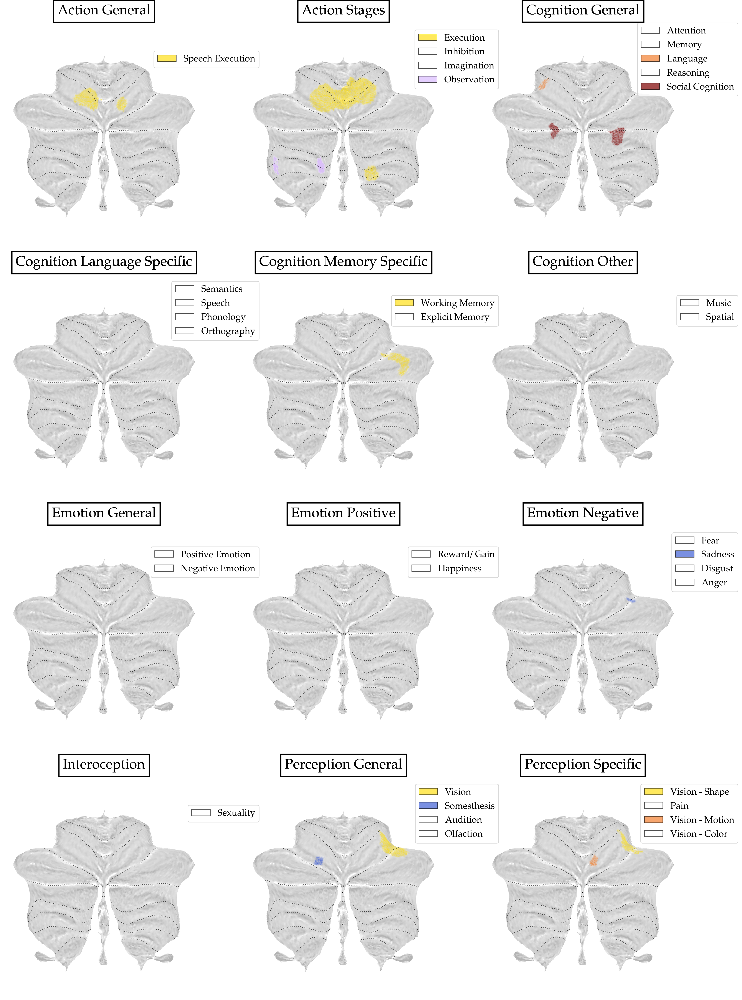

In [35]:
# Create a figure with a grid layout
fig = plt.figure(figsize=(21, 30))

# Loop over each semantic category
for i, (semantic_category, subdomains_in_category) in islice(enumerate(semantic_categories.items()), 12):
    ax = fig.add_subplot(4, 3, i + 1)

    # Filter subdomain_exps based on the subdomains in the current category and convert to Series
    subdomain_exps_in_category = {subdomain: subdomain_exps[subdomain] for subdomain in subdomains_in_category}

    # Create a Series with filtered subdomain_exps and sort by values in descending order
    subdomain_order_semantic_category = pd.Series(subdomain_exps_in_category).sort_values(ascending=False).index

    # Increase the alpha value to make the background less transparent
    grays_mild = LinearSegmentedColormap.from_list(
        'grays_mild', 
        [
            (1, 1, 1, 1), 
            (0.7, 0.7, 0.7, 1)  # to make bg grayer, change 0.7 to lower values
        ]
    )

    # Plot the background
    SUITPy.flatmap.plot(surf_zmaps_thr_strict['Cognition.Language'] * np.NaN, # This can be any map, but make sure to multiply by NaNs.
                        colorbar=False, new_figure=False, bordersize=0.5, 
                        undermap=grays_mild
                    )

    # Define your custom colormap for distinct colors. We did so above; any cmap of preference can be used.
    clusters_cmap = chosen_cmap
    clusters_colors = np.array([clusters_cmap(i) for i in range(clusters_cmap.N)])
    bg_color = (1, 1, 1, 0) # transparent white at the lower end of all cmaps
    clusters_colors[:, 3] = 0.2 # make cluster colors transparent. increase this to make clusters less transparent

    clusters_colors[3, 3] = 0.5  # Increased the alpha value for the 4th color (it is quite a faint pinkish hue)

    # Initialize a list to store legend handles
    legend_handles = []

    # Overlay clusters in a loop matching keys for subdomains to the semantic category they belong to
    for i, subdomain in enumerate(subdomain_order_semantic_category):
        matching_keys = [key for key in surf_zmaps_thr_strict.keys() if key.endswith(subdomain)]

        if matching_keys:
            cmap = LinearSegmentedColormap.from_list('cluster', [bg_color, clusters_colors[i]])
            curr_surf = surf_zmaps_thr_strict[matching_keys[0]] > 0
            SUITPy.flatmap.plot(curr_surf, 
                                colorbar=False, new_figure=False, bordersize=0, 
                                backgroundcolor=(0, 0, 0, 0), 
                                bordercolor='black',
                                underlay=np.zeros_like(curr_surf),
                                cmap=cmap, 
                            )

            # Add the semantic category title above the existing labels
            category_title = semantic_category.replace('_', ' ').title()
            ax.text(0.5, 1.10, f'{category_title}', fontsize=24, fontweight='bold', ha='center', va='center', transform=ax.transAxes, color='black', bbox=dict(facecolor='none', edgecolor='black', linewidth=2, pad = 7))  # Adjust linewidth value here

            # Check if curr_surf has all zeroes
            if np.all(curr_surf == 0):
                # Add a horizontal rectangle handle to the legend_handles list.  For empty maps it will be white.
                legend_handles.append(ax.bar(0, 0, color='white', edgecolor='black', alpha = 0.7, label=f"{subdomain_labels[subdomain]}")) # Remove subdomain N so we can size-up the subdomain labels.
            else:
                # Add the regular legend handle for non-zero cases. These will be colored by their index within the semantic category (1-5).
                legend_handles.append(ax.bar(0, 0, color=clusters_colors[i], edgecolor='black', alpha = 0.7, label=f"{subdomain_labels[subdomain]}"))
        else:
            # Handle the case when no matching key is found.
            print(f"No matching key found for subdomain: {subdomain}") # Several of the subdomains may not have survived p < 0.001 and k = 50 thresholding. Any map that is not in the dictionary is printed here.

    # Create a legend with the legend handles
    legend = ax.legend(handles=legend_handles,
                    loc='center right', bbox_to_anchor=(1.30, 0.87), prop={'size': 16})

# Show the entire figure containing all subplots
plt.show()


In [37]:
# Decide if you want to save the figure
fig.savefig(os.path.join(BASE_DIR, 'Figures/Publication/Figure3/Supplementary/SALE-Subd-Thres_binary-locations.png'), bbox_inches='tight')

# The End.